<a href="https://colab.research.google.com/github/EhabYasser25/YOLO-Shape-Detector/blob/main/YOLO_Shape_Detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Step 0: Libraries preparation

> ## Install necessary libraries

In [1]:
!pip install ultralytics
!pip install roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 618.1/618.1 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.7/58.7 kB 889.8 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.1 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.0.76

> ## Import necessary libraries

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import glob
import cv2
import os
from google.colab.patches import cv2_imshow
from IPython.display import Image, display
from ultralytics import YOLO
from ultralytics.utils.plotting import Annotator
from roboflow import Roboflow

# Step 1: Data preparation

> ## Change the root path to drive

In [3]:
from google.colab import drive
drive.mount('/content/drive/')
desired_path = '/content/drive/MyDrive/Colab Data/YOLO Shape Detector/'
os.chdir(desired_path)

Mounted at /content/drive/


> ## Discover the dataset

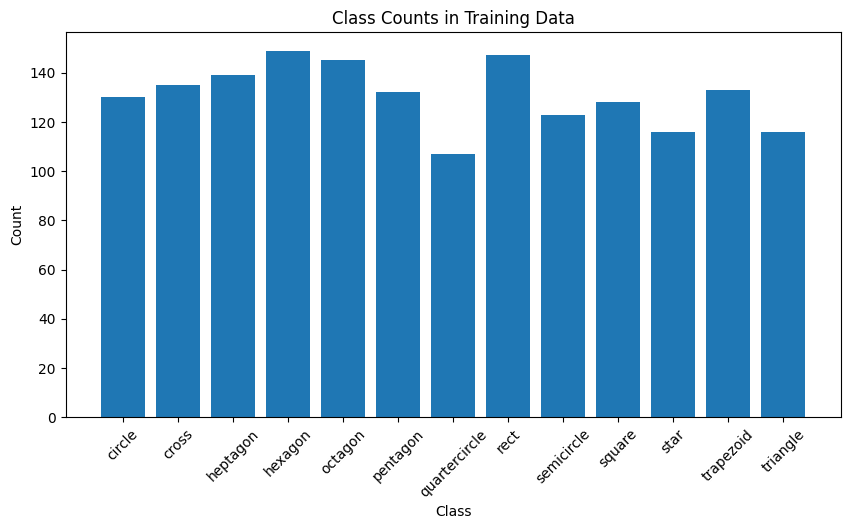

In [4]:
# Show the classes count in the train set

# Define initial arrays
dataset_dir = 'train/labels/'
class_names = ['circle', 'cross', 'heptagon', 'hexagon', 'octagon', 'pentagon', 'quartercircle', 'rect', 'semicircle', 'square', 'star', 'trapezoid', 'triangle']
class_counts = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

# Iterate on all labels
for filename in os.listdir(dataset_dir):
  with open(f'{dataset_dir}{filename}', 'r') as file:
    lines = file.readlines()
    for line in lines:
      class_id = int(line.split()[0])
      class_counts[class_id] += 1

# Plot drawing
plt.figure(figsize=(10, 5))
plt.bar(class_names, class_counts)
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Counts in Training Data')
plt.xticks(rotation=45)

plt.show()

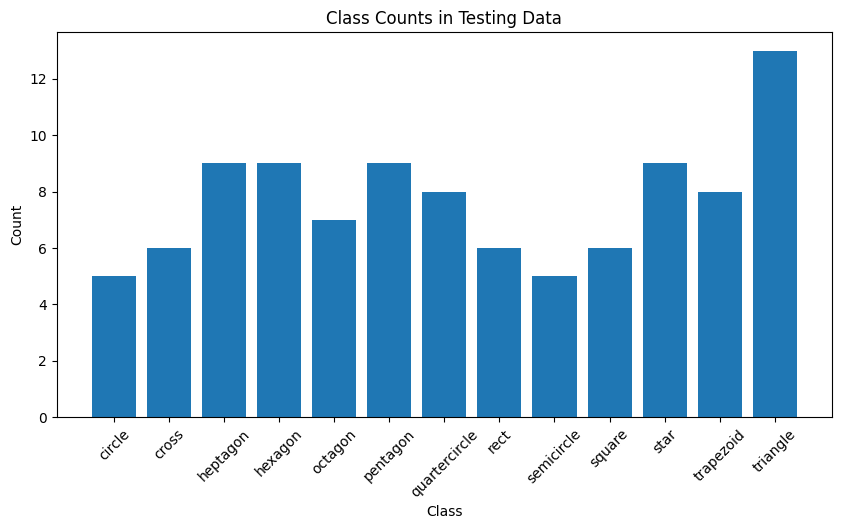

In [5]:
# Show the classes count in the test set

# Define initial arrays
dataset_dir = 'test/labels/'
class_names = ['circle', 'cross', 'heptagon', 'hexagon', 'octagon', 'pentagon', 'quartercircle', 'rect', 'semicircle', 'square', 'star', 'trapezoid', 'triangle']
class_counts = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

# Iterate on all labels
for filename in os.listdir(dataset_dir):
  with open(f'{dataset_dir}{filename}', 'r') as file:
    lines = file.readlines()
    for line in lines:
      class_id = int(line.split()[0])
      class_counts[class_id] += 1

# Plot drawing
plt.figure(figsize=(10, 5))
plt.bar(class_names, class_counts)
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Counts in Testing Data')
plt.xticks(rotation=45)

plt.show()

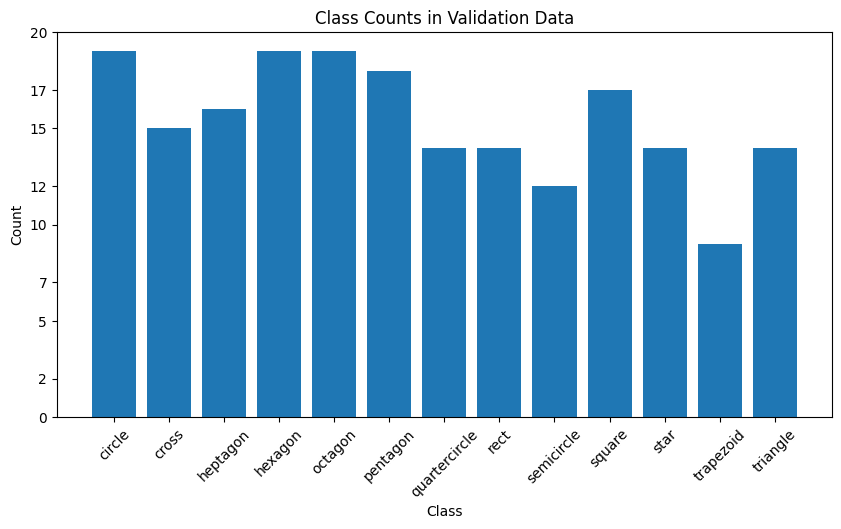

In [6]:
# Show the classes count in the validation set

# Define initial arrays
dataset_dir = 'valid/labels/'
class_names = ['circle', 'cross', 'heptagon', 'hexagon', 'octagon', 'pentagon', 'quartercircle', 'rect', 'semicircle', 'square', 'star', 'trapezoid', 'triangle']
class_counts = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

# Iterate on all labels
for filename in os.listdir(dataset_dir):
  with open(f'{dataset_dir}{filename}', 'r') as file:
    lines = file.readlines()
    for line in lines:
      class_id = int(line.split()[0])
      class_counts[class_id] += 1

# Plot drawing
plt.figure(figsize=(10, 5))
plt.bar(class_names, class_counts)
plt.xlabel('Class')
plt.ylabel('Count')
plt.yticks(list(map(int, plt.yticks()[0])))
plt.title('Class Counts in Validation Data')
plt.xticks(rotation=45)

plt.show()

# Step 2: Training

> ## Train the model

In [ ]:
# Choosing the model
model = YOLO("yolov8x.yaml")

# Training the model
results = model.train(data='data.yaml', epochs=40)


                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.conv.Conv             [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.conv.Conv             [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.block.C2f             [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.conv.Conv             [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.block.C2f             [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.conv.Conv             [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.block.C2f             [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytics.nn.modules.conv.Conv             [640

> ## Load the model

In [7]:
model = YOLO("runs/detect/train/weights/best.pt")

> ## Display the results

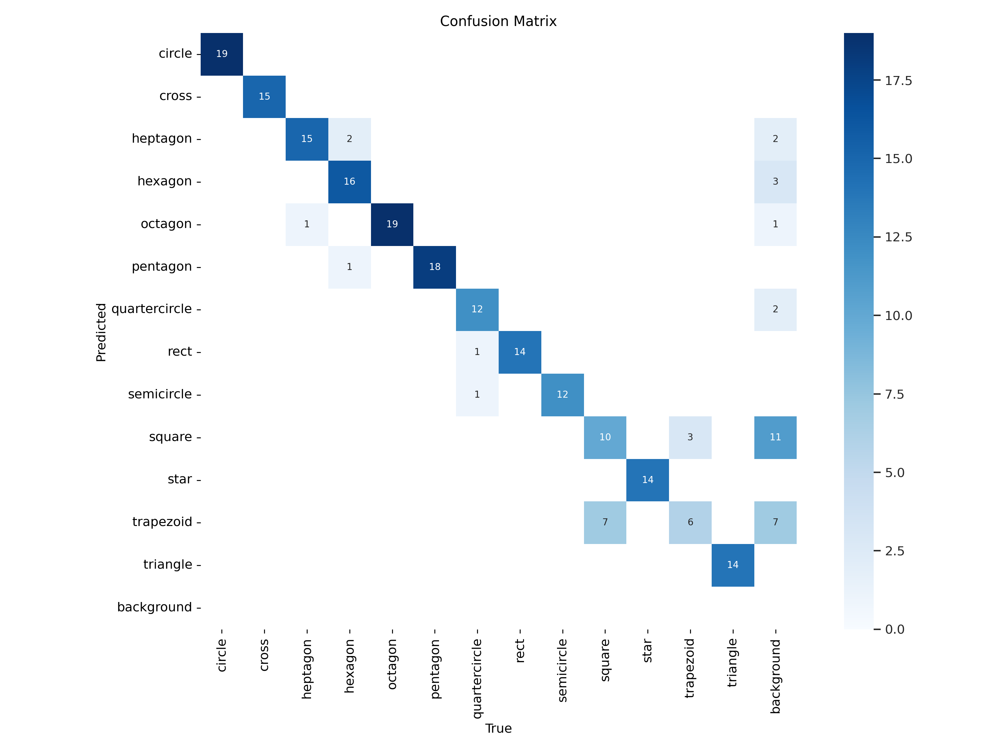

In [ ]:
# Show the training confusion matrix

confusion_matrix = cv2.imread('runs/detect/train/confusion_matrix.png')
cv2_imshow(confusion_matrix)

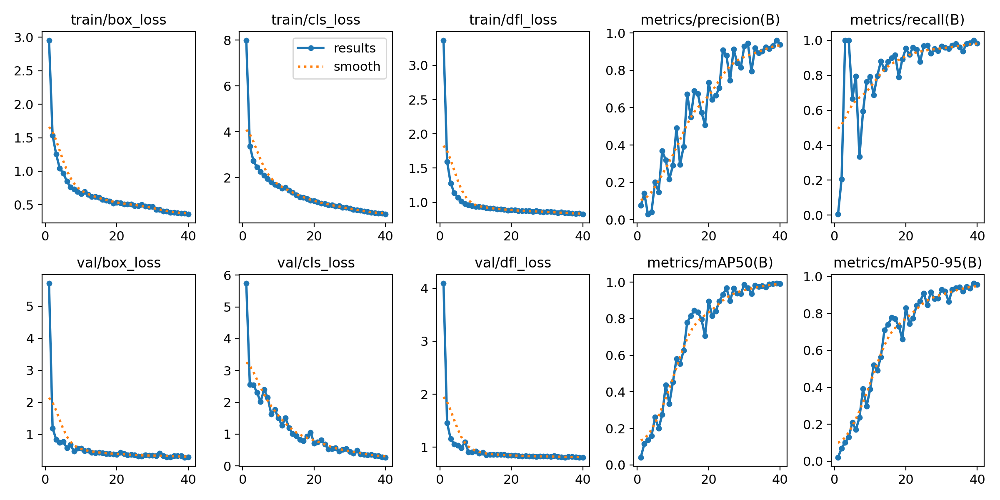

In [ ]:
# Show the training results

results = cv2.imread('runs/detect/train/results.png')
cv2_imshow(results)

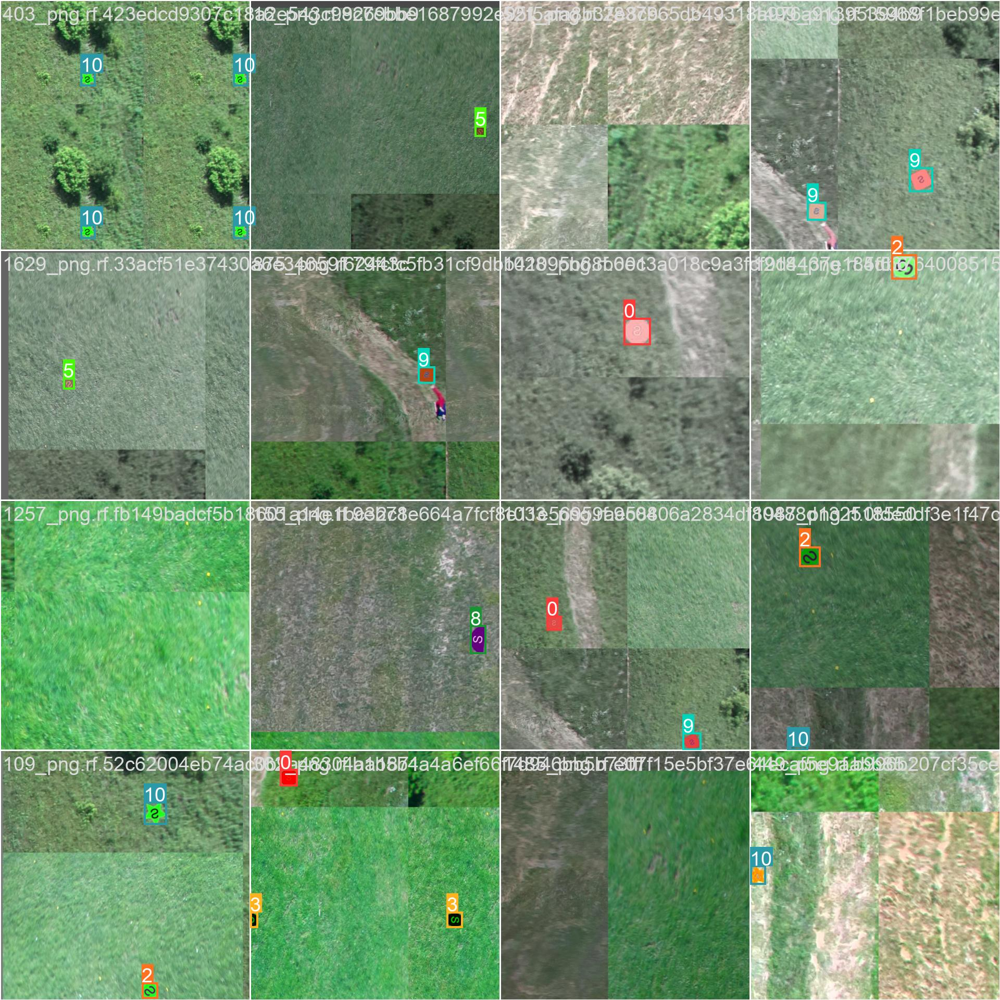

In [ ]:
# Show the training batch

train_batch = cv2.imread('runs/detect/train/train_batch0.jpg')
cv2_imshow(train_batch)

In [ ]:
# Show the validation mAP

print(f'mAP on validation dataset: {metrics.box.map*100:.2f}%')

Ultralytics YOLOv8.0.182 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
val: Scanning /content/drive/MyDrive/Colab Data/YOLO Shape Detector/valid/labels.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:18<00:00,  1.46s/it]
                   all        200        200      0.987      0.972      0.982      0.957
                circle        200         19          1          1      0.995      0.966
                 cross        200         15          1          1      0.995      0.971
              heptagon        200         16          1      0.938      0.969      0.969
               hexagon        200         19          1          1      0.995      0.947
               octagon        200         19          1          1      0.995      0.968
              pentagon        200         18          1          1    


mAP on validation dataset: 95.68%


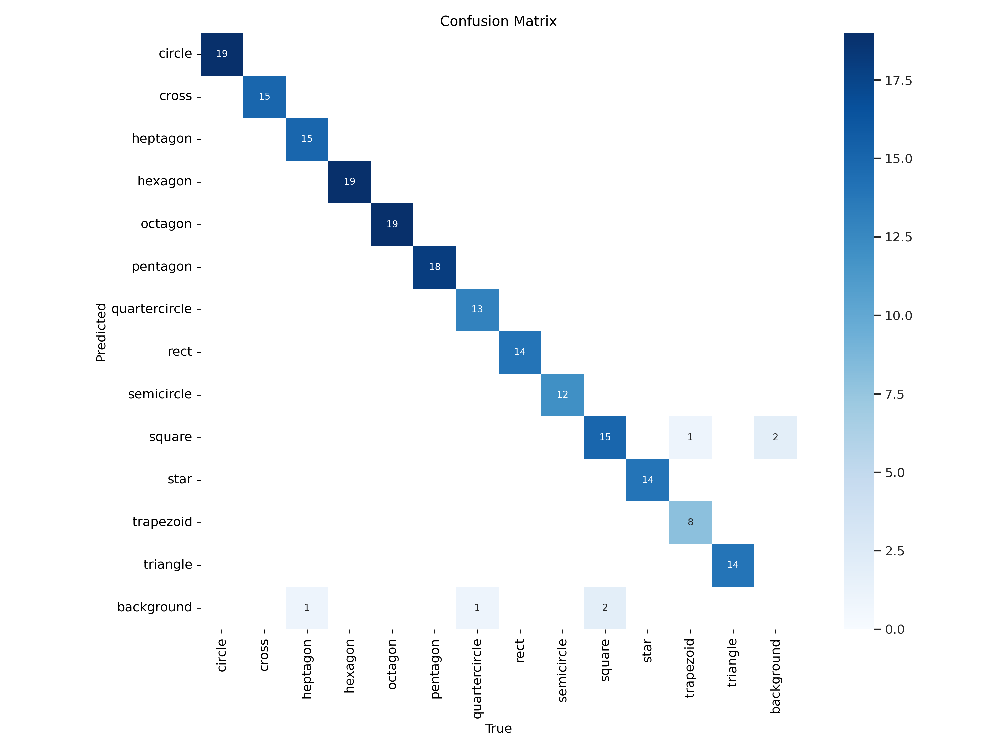

In [ ]:
# Show the validation confusion matrix

confusion_matrix = cv2.imread('runs/detect/val/confusion_matrix.png')
cv2_imshow(confusion_matrix)

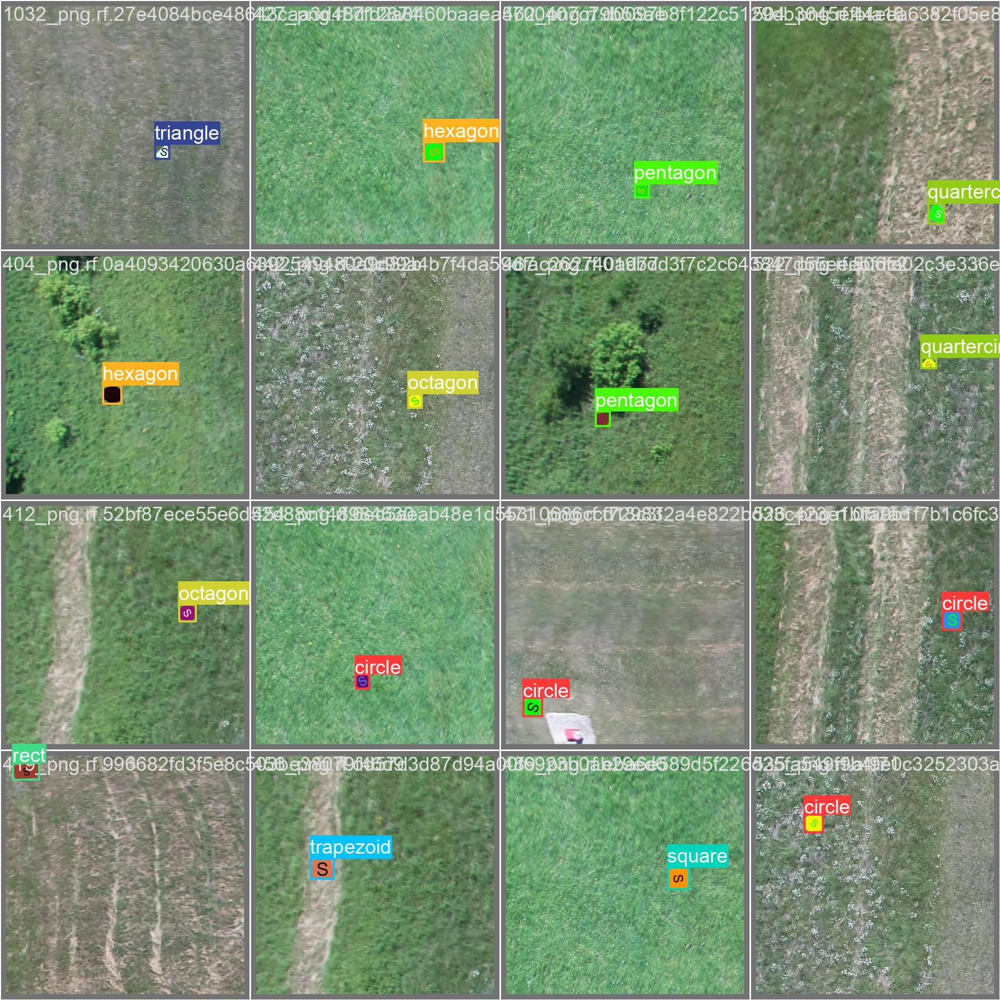

In [ ]:
# Show the validation batch

train_batch = cv2.imread('runs/detect/val/val_batch0_labels.jpg')
cv2_imshow(train_batch)

# Step 3: Testing

> ## Test the data

In [14]:
# Predict on the whole test images
predictions = model.predict('test/images/', conf=0.6)


image 1/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1079_png.rf.3ebf3c5d8fe90f9501caec3c82cb0113.jpg: 640x640 1 triangle, 5149.9ms
image 2/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1094_png.rf.cb4d7485537ee370c6b869d96cd24ac6.jpg: 640x640 1 square, 4878.7ms
image 3/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1096_png.rf.8f4ac6524b20ecccca3079c342e18a6d.jpg: 640x640 1 trapezoid, 8719.4ms
image 4/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1112_png.rf.c287c21bb2d33b233e52c6f0dbbc01d5.jpg: 640x640 1 quartercircle, 5277.2ms
image 5/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1118_png.rf.d0a82b0dc1dabebe71d0c80c1064c183.jpg: 640x640 1 heptagon, 6817.5ms
image 6/100 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1120_png.rf.92332fb3fac470a2842637fe65d7499c.jpg: 640x640 1 star, 5932.2ms
image 7/100 /content/drive/MyDrive/Colab Data/YOLO Shape 

> ## Show some test images


image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1128_png.rf.3fba9924f0fe814aca570b7a8e59e420.jpg: 640x640 1 star, 4374.3ms
Speed: 2.6ms preprocess, 4374.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


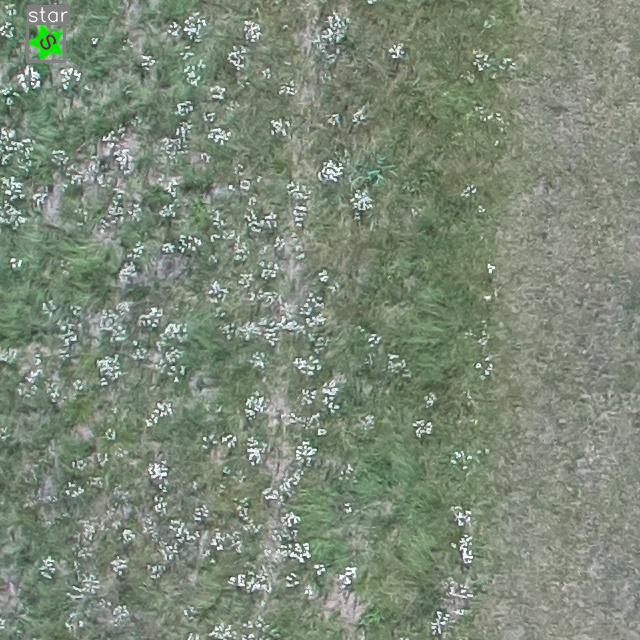

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1118_png.rf.d0a82b0dc1dabebe71d0c80c1064c183.jpg: 640x640 1 heptagon, 6592.1ms
Speed: 2.5ms preprocess, 6592.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


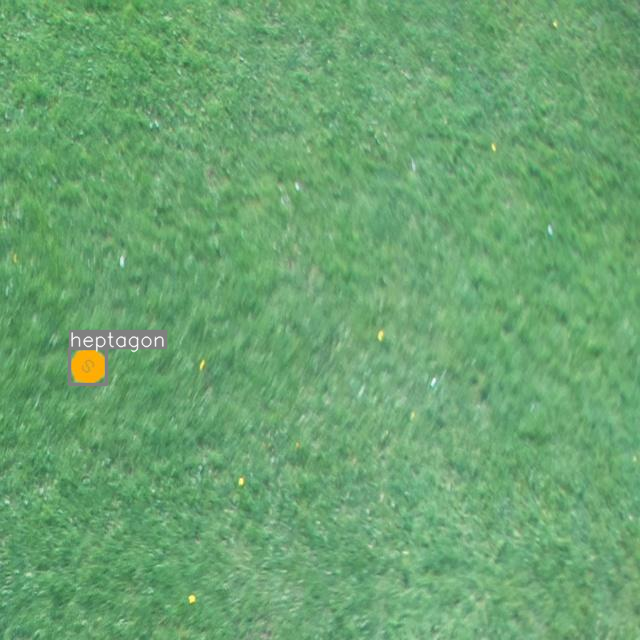

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/13_png.rf.f5f1e2e3136eb434ba78ab23a7cb72f3.jpg: 640x640 1 rect, 4451.2ms
Speed: 3.3ms preprocess, 4451.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


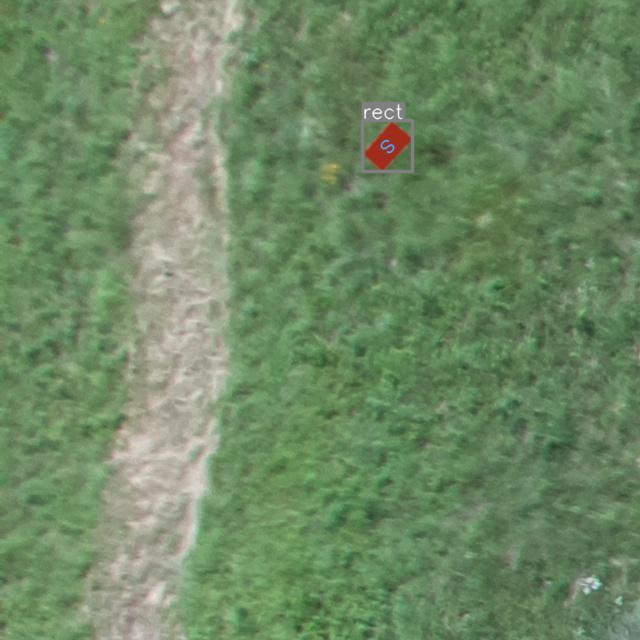

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1120_png.rf.92332fb3fac470a2842637fe65d7499c.jpg: 640x640 1 star, 4475.9ms
Speed: 2.6ms preprocess, 4475.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


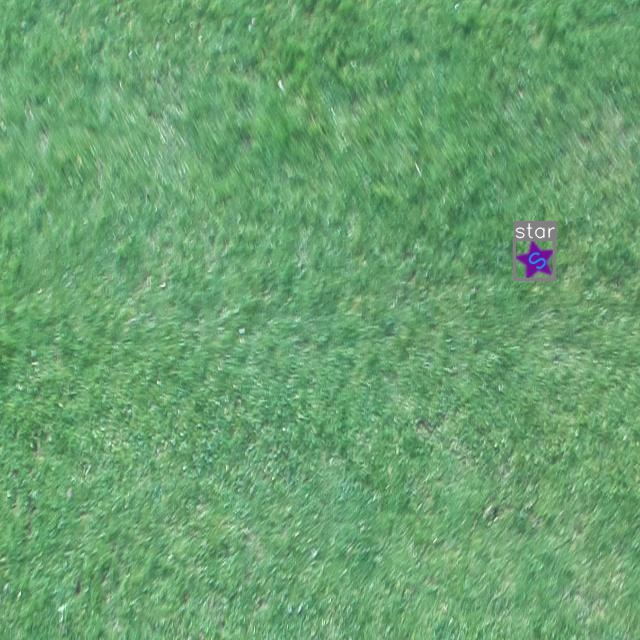

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1190_png.rf.1bb597e79f5badf04532a4b757a86f33.jpg: 640x640 1 heptagon, 6334.3ms
Speed: 2.6ms preprocess, 6334.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


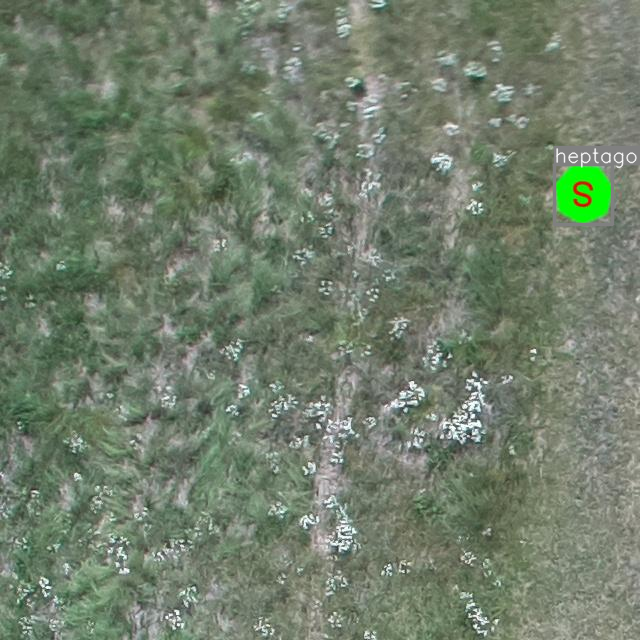

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1188_png.rf.77e1ce4402c38e46f319afc100b62834.jpg: 640x640 1 quartercircle, 4514.2ms
Speed: 2.6ms preprocess, 4514.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


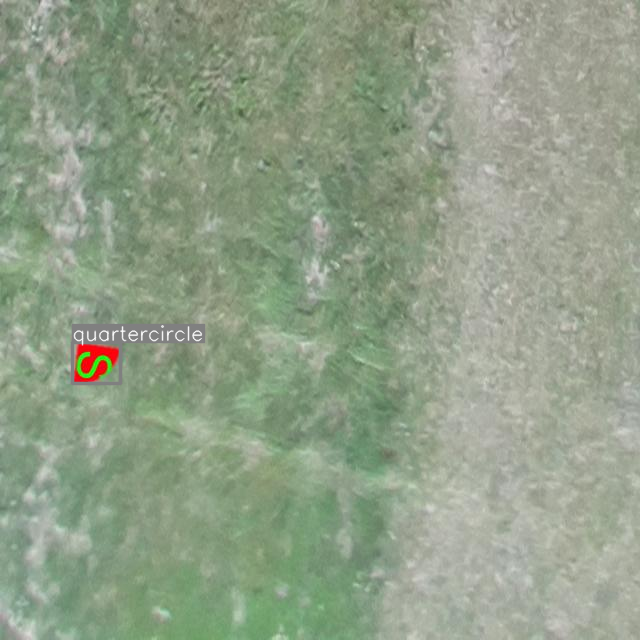

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1245_png.rf.f0c7a9f0f2fb34c0c98750f8468f2b78.jpg: 640x640 1 star, 4806.5ms
Speed: 2.5ms preprocess, 4806.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


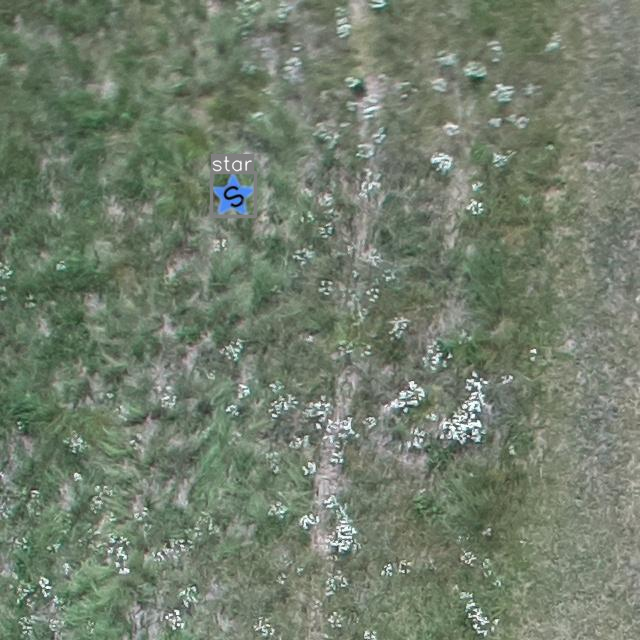

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1351_png.rf.98d547347b981c8ab54a89f84c1a7827.jpg: 640x640 1 hexagon, 6026.5ms
Speed: 2.5ms preprocess, 6026.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


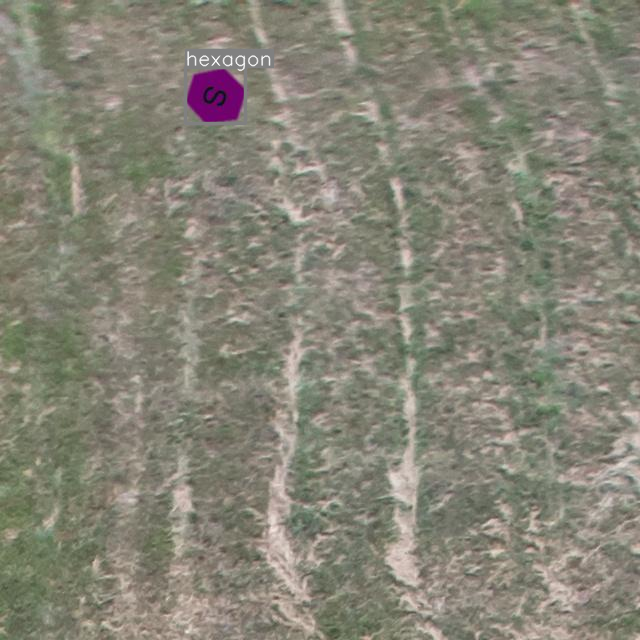

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1096_png.rf.8f4ac6524b20ecccca3079c342e18a6d.jpg: 640x640 1 trapezoid, 4527.4ms
Speed: 2.6ms preprocess, 4527.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


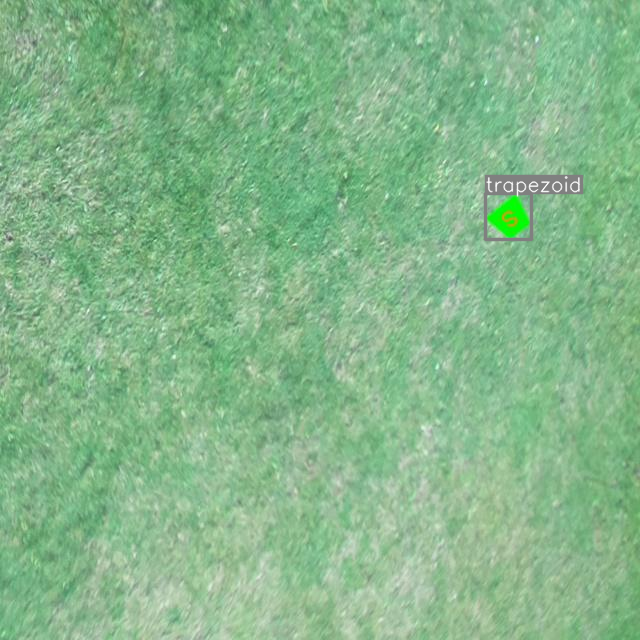

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1249_png.rf.5fa0870b2d16a0fc5cb71a0511b782dd.jpg: 640x640 1 triangle, 5466.1ms
Speed: 2.6ms preprocess, 5466.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


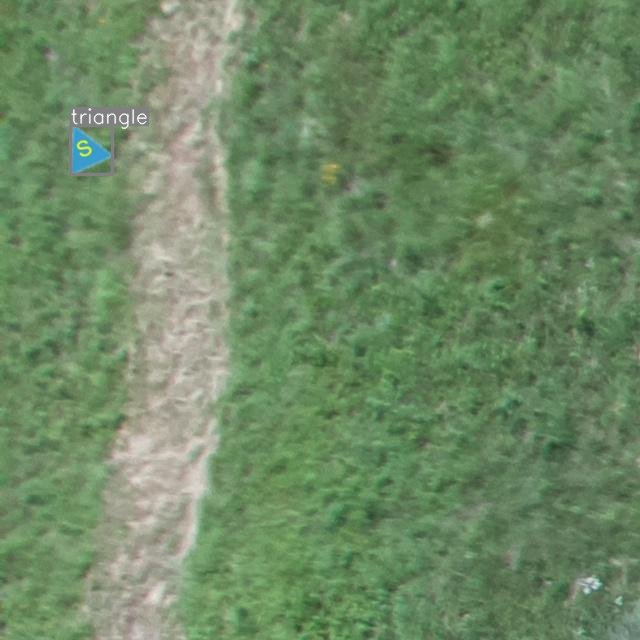

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1079_png.rf.3ebf3c5d8fe90f9501caec3c82cb0113.jpg: 640x640 1 triangle, 5648.1ms
Speed: 2.6ms preprocess, 5648.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


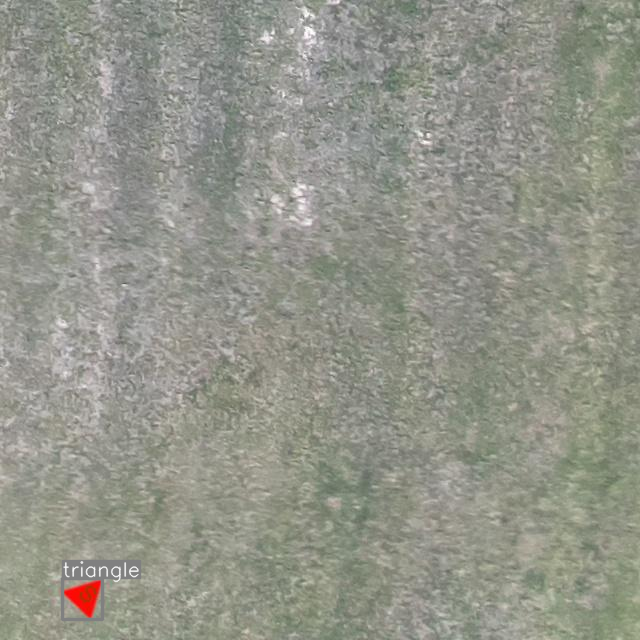

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1170_png.rf.56068e2d62a8c6c246661b94241b5986.jpg: 640x640 1 pentagon, 4612.9ms
Speed: 2.6ms preprocess, 4612.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


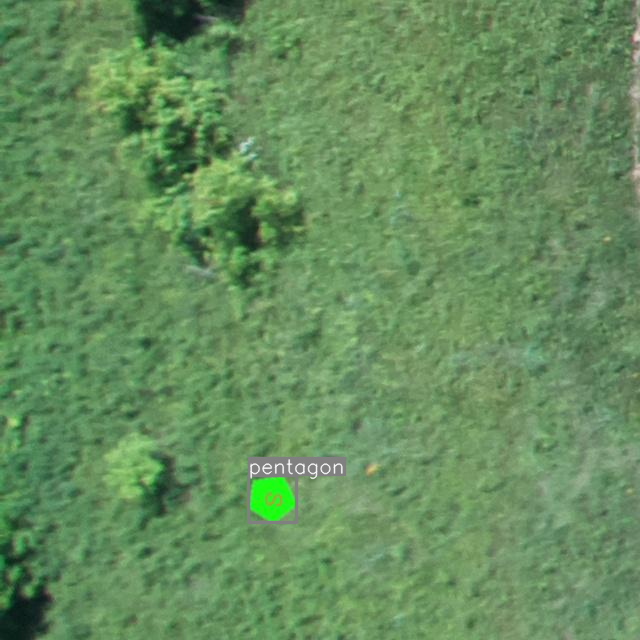

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1278_png.rf.dc6e98c7649265f30cc551a870bc5a4b.jpg: 640x640 1 circle, 5972.6ms
Speed: 2.7ms preprocess, 5972.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


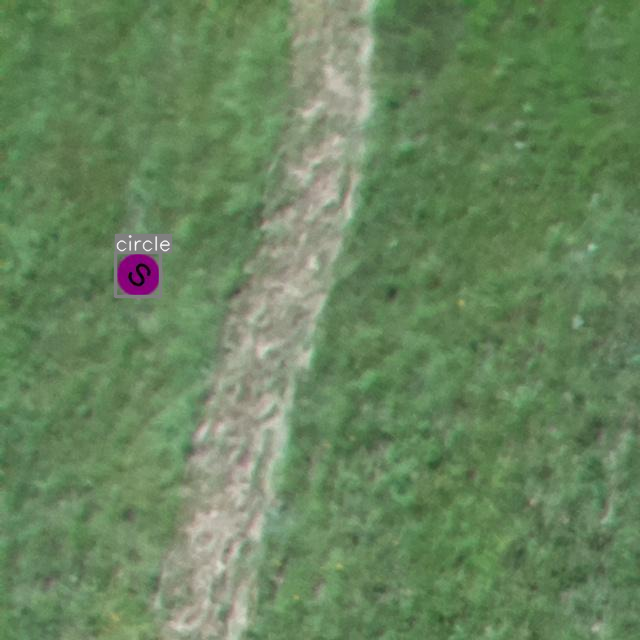

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1112_png.rf.c287c21bb2d33b233e52c6f0dbbc01d5.jpg: 640x640 1 quartercircle, 5109.4ms
Speed: 2.6ms preprocess, 5109.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


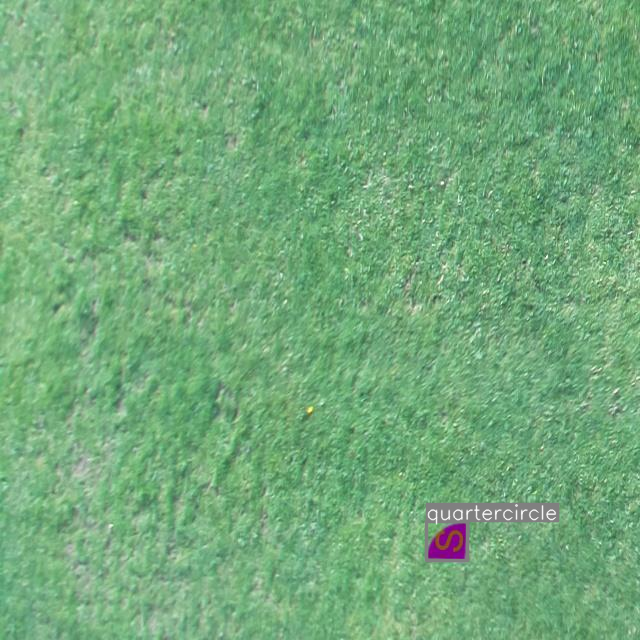

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1398_png.rf.7e44d1fcfbb7d1e042ed950cf18e5031.jpg: 640x640 1 hexagon, 4576.7ms
Speed: 2.9ms preprocess, 4576.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


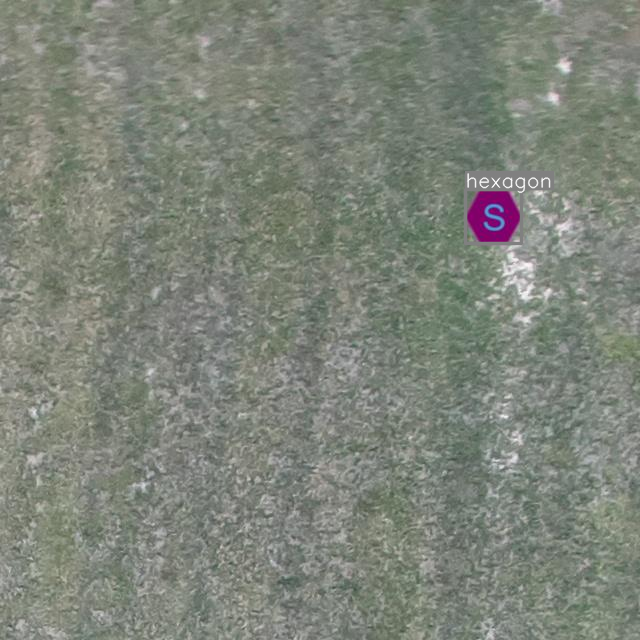

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1142_png.rf.176cee81461f77cd472c6d449a1ada44.jpg: 640x640 1 square, 6599.2ms
Speed: 3.6ms preprocess, 6599.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


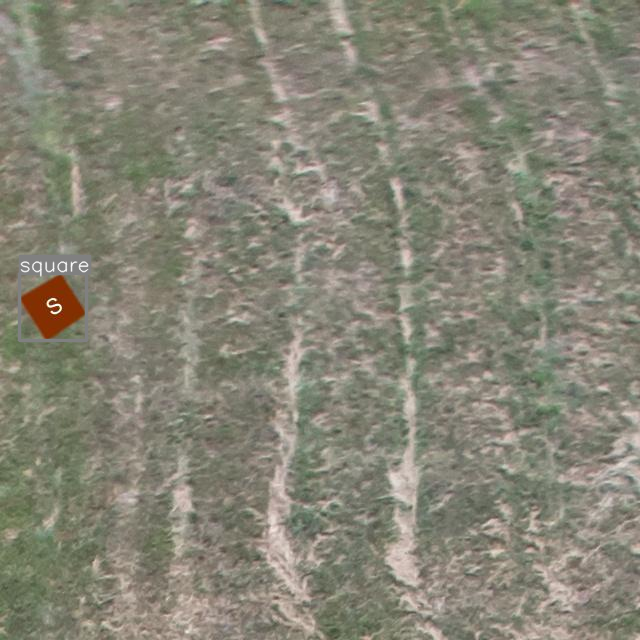

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1094_png.rf.cb4d7485537ee370c6b869d96cd24ac6.jpg: 640x640 1 square, 4751.6ms
Speed: 5.7ms preprocess, 4751.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


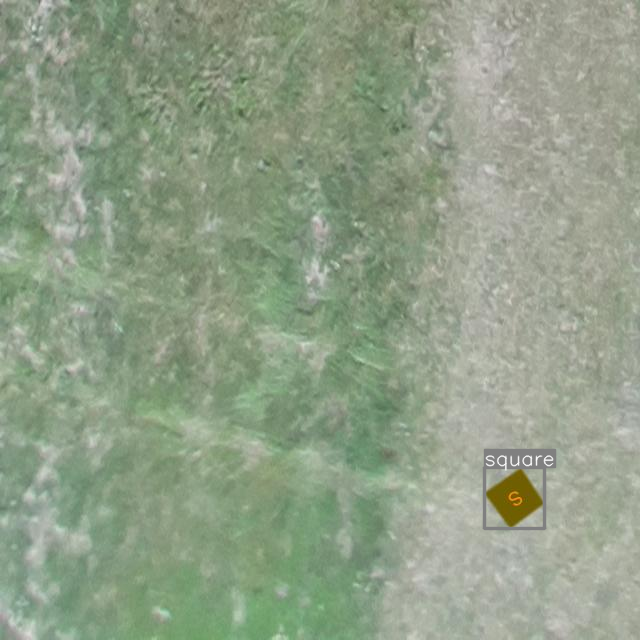

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/1210_png.rf.91b83755c84437ba63a82b1b83bfdd50.jpg: 640x640 1 rect, 4551.0ms
Speed: 3.5ms preprocess, 4551.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


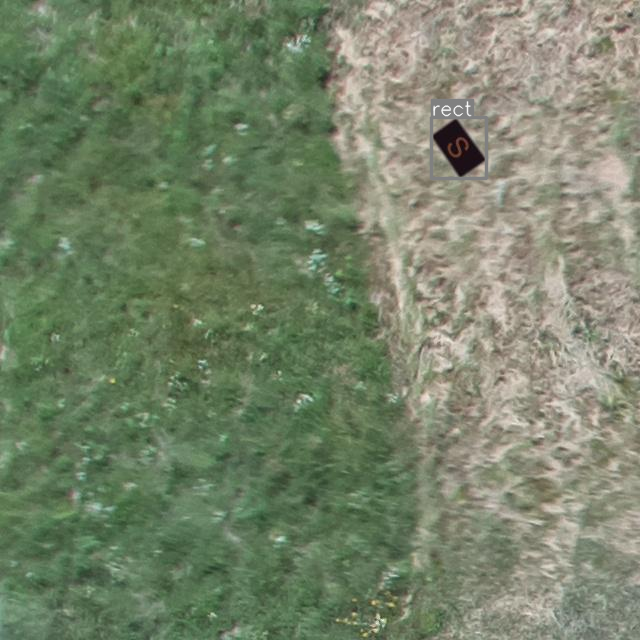

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/128_png.rf.113700b9fc0ed640b7f4a8c5ce04a945.jpg: 640x640 1 star, 6768.9ms
Speed: 2.6ms preprocess, 6768.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


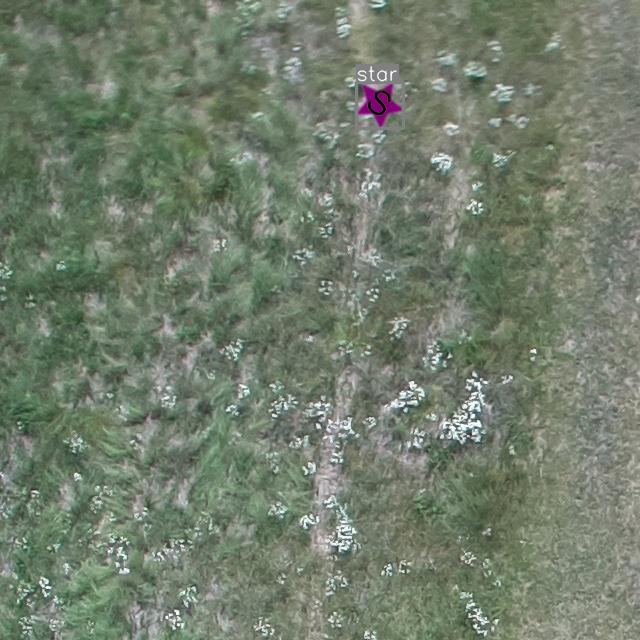

image 1/1 /content/drive/MyDrive/Colab Data/YOLO Shape Detector/test/images/115_png.rf.bed7bd5460cba83fc8815805218d60ee.jpg: 640x640 1 triangle, 4684.8ms
Speed: 2.6ms preprocess, 4684.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


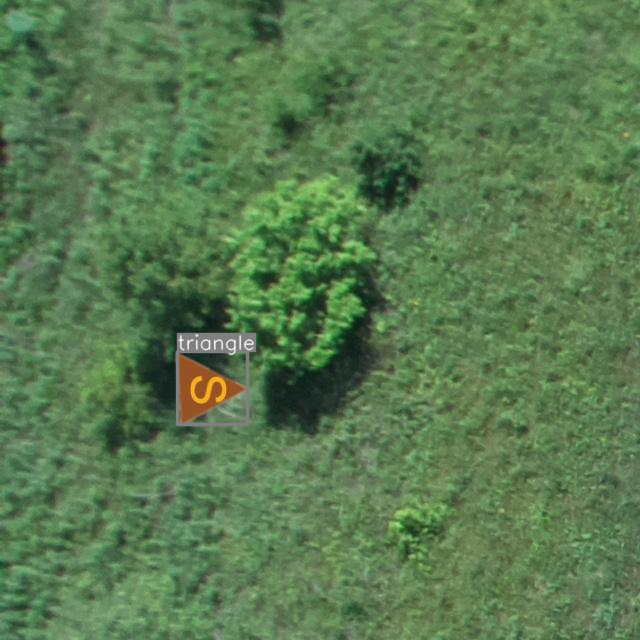

In [15]:
# Show only 20 predicted test images
limit = 20
count = 0

# Load the test images
for image_name in os.listdir('test/images/'):

  if count == limit:
    break

  image_path = f'test//images/{image_name}'
  image = cv2.imread(image_path)
  prediction = model.predict(image_path, conf=0.6)[0]

  # Create an Annotator object for the image
  annotator = Annotator(image)

  boxes = prediction.boxes
  for box in boxes:
    b = box.xyxy[0] # Get box coordinates
    c = box.cls
    annotator.box_label(b, model.names[int(c)])

  # Display the image with the drawn bounding box
  cv2_imshow(image)
  print()

  count += 1

# Step 4: Inference

> ## Define inference function

In [36]:
def inference(image):
  results = model.predict(image)

  annotator = Annotator(image)
  boxes = results[0].boxes
  for box in boxes:
    b = box.xyxy[0] # Get box coordinates
    c = box.cls
    annotator.box_label(b, model.names[int(c)])

  # Display the image with the drawn bounding boxes
  cv2_imshow(image)


0: 640x640 1 triangle, 4413.4ms
Speed: 8.6ms preprocess, 4413.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


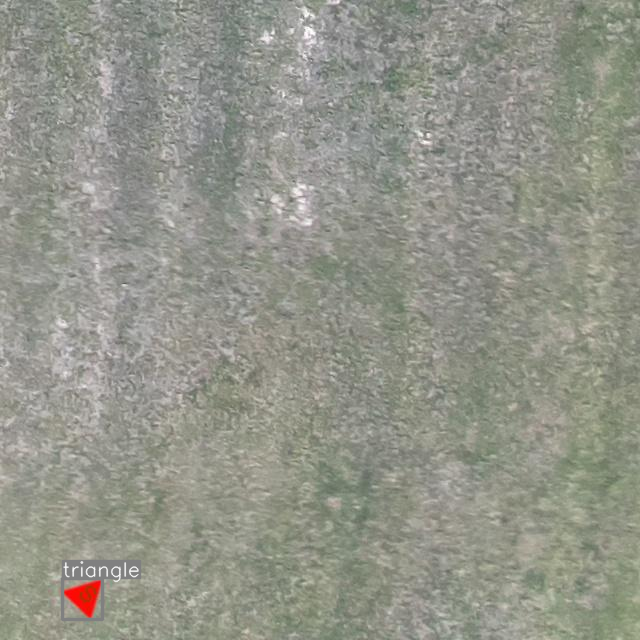

In [37]:
image = cv2.imread('test/images/1079_png.rf.3ebf3c5d8fe90f9501caec3c82cb0113.jpg')
inference(image)